### Imports

In [257]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import re
import pandas as pd
import json


import folium
from folium import plugins
from folium.plugins import HeatMap, HeatMapWithTime, MarkerCluster
from geopy.geocoders import Nominatim


from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn import metrics
from sklearn.preprocessing import StandardScaler


### Reading in the Data

In [177]:
df = pd.read_csv('../data/rio.csv')
df.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,783493769216852616,https://www.airbnb.com/rooms/783493769216852616,20221229002515,2022-12-29,city scrape,"Leme, Brasil",Apartamento aconchegante próximo à praia do Le...,NaN,https://a0.muscache.com/pictures/fe1f4b1b-a300...,491704706,...,NaN,NaN,NaN,NaN,f,2,2,0,0,NaN
1,703973293620197060,https://www.airbnb.com/rooms/703973293620197060,20221229002515,2022-12-29,city scrape,Suíte com entrada independente em casarão 1,"Casa ampla, em excelente localização, situada ...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,20362236,...,5.00,4.00,5.00,NaN,t,4,0,4,0,0.26
2,782895997622988215,https://www.airbnb.com/rooms/782895997622988215,20221229002515,2022-12-29,city scrape,Apartamento próximo ao metrô,Sua família vai estar perto de tudo ao ficar n...,NaN,https://a0.muscache.com/pictures/d48a6798-d1c8...,302417043,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
3,23768085,https://www.airbnb.com/rooms/23768085,20221229002515,2022-12-29,city scrape,Vamos a praia,"Ótimo apartamento para duas pessoas, de frente...","Localização: praia da Barra da Tijuca, Posto 2...",https://a0.muscache.com/pictures/e43b686c-c4b4...,86611015,...,4.88,4.98,4.78,NaN,t,1,1,0,0,1.59
4,10463735,https://www.airbnb.com/rooms/10463735,20221229002515,2022-12-29,city scrape,Sobrado aconchegante e espaçoso,"Sobrado amplo, arejado, com arquitetura inusit...",Laranjeiras é um bairro histórico do Rio de Ja...,https://a0.muscache.com/pictures/52ffaa78-2e94...,53918534,...,1.00,2.00,1.00,NaN,t,6,2,4,0,0.03


In [178]:
type(df)

pandas.core.frame.DataFrame

In [179]:
df.shape

(28301, 75)

### Getting some basic stats on the data...

In [180]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28301 entries, 0 to 28300
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            28301 non-null  int64  
 1   listing_url                                   28301 non-null  object 
 2   scrape_id                                     28301 non-null  int64  
 3   last_scraped                                  28301 non-null  object 
 4   source                                        28301 non-null  object 
 5   name                                          28272 non-null  object 
 6   description                                   27535 non-null  object 
 7   neighborhood_overview                         14784 non-null  object 
 8   picture_url                                   28301 non-null  object 
 9   host_id                                       28301 non-null 

In [181]:
df.isnull().sum().sort_values()

id                                  0
calendar_last_scraped               0
neighbourhood_cleansed              0
availability_365                    0
latitude                            0
                                ...  
host_about                      14589
calendar_updated                28301
license                         28301
neighbourhood_group_cleansed    28301
bathrooms                       28301
Length: 75, dtype: int64

### General notes... 

* 1. note that the bathrooms column is full of nans but bathrooms_text has the bathroom info
* 2. also note that price is an object and will need to be converted
* 3. several object values that are redundant, seemingly unnecessary and can be dropped
* 4. room type is unorganized yet contains inportant info about what the size / type of the property, this needs to be cleaned


In [182]:
df.room_type.value_counts()

Entire home/apt    22093
Private room        5685
Shared room          470
Hotel room            53
Name: room_type, dtype: int64

In [183]:
df.bathrooms_text.value_counts()

1 bath               12055
2 baths               5713
1 shared bath         2081
1 private bath        1804
3 baths               1543
1.5 baths             1497
2.5 baths             1018
2 shared baths         459
3.5 baths              393
1.5 shared baths       379
4 baths                358
4.5 baths              157
5 baths                130
3 shared baths          82
5.5 baths               79
6 baths                 75
2.5 shared baths        74
7 baths                 47
6.5 baths               45
0 baths                 43
8 baths                 31
4 shared baths          31
0 shared baths          26
7.5 baths               26
Shared half-bath        13
3.5 shared baths        12
5 shared baths          10
6 shared baths           8
11 baths                 8
8.5 baths                8
Half-bath                6
8 shared baths           6
7 shared baths           6
9 baths                  5
10 baths                 4
11.5 baths               4
4.5 shared baths         3
1

In [184]:
df.groupby('room_type')['bathrooms_text'].value_counts()

room_type        bathrooms_text  
Entire home/apt  1 bath              11513
                 2 baths              5419
                 3 baths              1484
                 1.5 baths            1313
                 2.5 baths             981
                                     ...  
Shared room      6.5 shared baths        2
                 8 shared baths          2
                 3.5 shared baths        1
                 4.5 shared baths        1
                 9 shared baths          1
Name: bathrooms_text, Length: 82, dtype: int64

### CLeaning up the bathroom information...

In [185]:
# writing a function to seperate the text and extract the number of baths in the property

df['baths'] = ''

for idx, i in enumerate(df['bathrooms_text']):
    if isinstance(i, float):
        # Handle the case where the value is a float
        df['baths'][idx] = 0
    else:
        i = ''.join([x for x in i if x != ' ' or x != None])
        if i == 'Half-bath':
            df['baths'][idx] = 0.5
        elif i == '':
            df['baths'][idx] = 0
        elif 'half-bath' in i:
            df['baths'][idx] = 0.5
        elif i == None:
            df['baths'][idx] = 0
        elif isinstance(i, str):
            # Use a regular expression to extract the numeric portion of the string
            matches = re.findall(r'[\d\.]+', i)
            if len(matches) > 0:
                df['baths'][idx] = float(matches[0])
            else:
                df['baths'][idx] = 0

/var/folders/ls/rb0w9bbn24x0kssdjbf1scxh0000gn/T/ipykernel_69366/2686442115.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['baths'][idx] = float(matches[0])
/var/folders/ls/rb0w9bbn24x0kssdjbf1scxh0000gn/T/ipykernel_69366/2686442115.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['baths'][idx] = 0
/var/folders/ls/rb0w9bbn24x0kssdjbf1scxh0000gn/T/ipykernel_69366/2686442115.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-co

In [186]:
df['baths'].dtypes

dtype('O')

* convert baths to integer for analysis

In [187]:
df['baths'] = pd.to_numeric(df['baths'])

In [188]:
df['baths'].dtypes

dtype('float64')

In [189]:
df['baths']

0        1.0
1        1.0
2        1.0
3        1.0
4        2.0
        ... 
28296    2.0
28297    1.0
28298    1.0
28299    1.0
28300    1.0
Name: baths, Length: 28301, dtype: float64

In [190]:
df['baths'].value_counts()

1.0     15940
2.0      6172
1.5      1876
3.0      1625
2.5      1092
3.5       405
4.0       389
4.5       160
5.0       140
0.0       115
6.0        83
5.5        80
7.0        53
6.5        47
8.0        37
7.5        26
0.5        21
8.5         9
11.0        8
9.0         6
10.0        4
11.5        4
15.0        3
10.5        2
16.0        1
15.5        1
12.0        1
20.0        1
Name: baths, dtype: int64

In [191]:
df['baths'].isnull().sum()

0

### Cleaning the price feature for better analysis

In [192]:
df.price

0        $720.00
1        $599.00
2        $240.00
3        $494.00
4        $581.00
          ...   
28296    $871.00
28297    $194.00
28298    $153.00
28299    $457.00
28300    $200.00
Name: price, Length: 28301, dtype: object

In [193]:
# price is currently an object with special character and the need to be removed, the it needs to be converted to a numerical variable
df.price = df.price.str.replace('$', '').str.replace(',', '').astype(float)
df.price

/var/folders/ls/rb0w9bbn24x0kssdjbf1scxh0000gn/T/ipykernel_69366/3932344219.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df.price = df.price.str.replace('$', '').str.replace(',', '').astype(float)


0        720.0
1        599.0
2        240.0
3        494.0
4        581.0
         ...  
28296    871.0
28297    194.0
28298    153.0
28299    457.0
28300    200.0
Name: price, Length: 28301, dtype: float64

In [194]:
df.price.dtypes

dtype('float64')

* looking for variables that correlate with / impact price

In [315]:
correlations = df.corr()['price'].sort_values(ascending=False).apply(lambda x: f'{x*100:.2f}%')
correlations

price                                           100.00%
baths                                             8.43%
accommodates                                      8.10%
bedrooms                                          7.72%
beds                                              5.52%
calculated_host_listings_count_entire_homes       4.19%
host_total_listings_count                         4.15%
calculated_host_listings_count                    4.10%
host_listings_count                               2.98%
minimum_nights_avg_ntm                            2.30%
minimum_minimum_nights                            2.29%
minimum_nights                                    2.25%
maximum_minimum_nights                            1.92%
availability_30                                   1.51%
availability_60                                   1.38%
availability_90                                   1.37%
availability_365                                  1.24%
id                                              

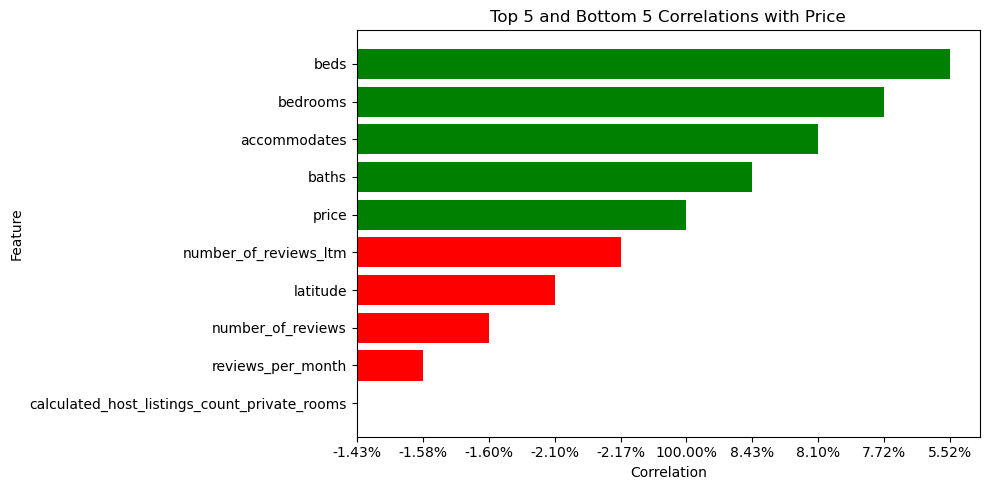

In [323]:
# calculate the correlation of each column with the 'price' column and sort in descending order
corr = df.corr()['price'].sort_values(ascending=False).apply(lambda x: f'{x*100:.2f}%')

# create a horizontal bar chart for top 5 and bottom 5 correlations, in reverse order
top_and_bottom = pd.concat([corr.head(5), corr.tail(5)][::-1])
colors = ['r']*5 + ['g']*5  # green for top 5, red for bottom 5
plt.figure(figsize=(10, 5))
plt.barh(top_and_bottom.index, top_and_bottom.values, color=colors)
plt.title('Top 5 and Bottom 5 Correlations with Price')
plt.xlabel('Correlation')
plt.ylabel('Feature')
plt.tight_layout()

plt.savefig('../visualizations/price correlation.jpg')
plt.show()


### preliminary correlation thoughts...

1. VERY little general correlation between the variables and price!
2. strongest correlation between accomodates, bedrooms, and beds.
3. bedrooms are 'rooms' , beds is the total number of beds in the property
4. the number of beds directly impacts how many people a property can accomodate. Is accomodate a stronger feature to consider?
5. how does location play a part? - latitude / longtitude? proximity to the water? restaurants? night life? neighborhood?
6. property type - will need to clean up the property type possibly the room type to make categorical

### property type data / room type data...

In [196]:
df.property_type.dtypes

dtype('O')

In [197]:
df.property_type.unique()

array(['Entire rental unit', 'Private room in bed and breakfast',
       'Entire home', 'Entire serviced apartment',
       'Private room in rental unit', 'Private room in casa particular',
       'Entire condo', 'Entire villa', 'Room in hotel', 'Entire loft',
       'Shared room in rental unit', 'Private room in condo',
       'Private room in home', 'Private room in cottage', 'Earthen home',
       'Private room in villa', 'Private room in resort',
       'Shared room in hostel', 'Private room in serviced apartment',
       'Shared room in condo', 'Private room in nature lodge',
       'Houseboat', 'Entire vacation home', 'Entire guesthouse',
       'Entire place', 'Shared room in bed and breakfast',
       'Room in aparthotel', 'Private room in guest suite',
       'Shared room in guesthouse', 'Room in boutique hotel',
       'Casa particular', 'Shared room in home', 'Entire guest suite',
       'Private room in earthen home', 'Private room in boat',
       'Private room', 'Entire c

In [198]:
df.room_type.unique()

array(['Entire home/apt', 'Private room', 'Hotel room', 'Shared room'],
      dtype=object)

In [199]:
df.room_type.value_counts()

Entire home/apt    22093
Private room        5685
Shared room          470
Hotel room            53
Name: room_type, dtype: int64

* both categories (property type and room) - either the renter has the entire property, or has a shared or private room within the property. We can break this down into three categories

In [200]:
# Create a new column 'property_category' and set its default value to None
df['property_category'] = None

# Define a mapping of property type keywords to categories
property_type_map = {'entire': 'Entire', 'private': 'Private', 'shared': 'Shared'}

# Loop over each row in the 'property_type' column and update the 'property_category' column
for index, row in df.iterrows():
    for key, value in property_type_map.items():
        if key in row['property_type'].lower():
            df.at[index, 'property_category'] = value

            
df.property_category

0         Entire
1        Private
2         Entire
3         Entire
4         Entire
          ...   
28296     Entire
28297     Entire
28298     Entire
28299     Entire
28300    Private
Name: property_category, Length: 28301, dtype: object

In [201]:
df.property_category.unique()

array(['Entire', 'Private', None, 'Shared'], dtype=object)

In [202]:
df['property_category'] = df['property_category'].fillna('Other')
df.property_category.unique()

array(['Entire', 'Private', 'Other', 'Shared'], dtype=object)

In [203]:
df.property_category.value_counts()

Entire     21938
Private     5481
Shared       470
Other        412
Name: property_category, dtype: int64

### Editing Columns - dropping & changing value types

In [204]:
df.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'ca

In [205]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28301 entries, 0 to 28300
Data columns (total 77 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            28301 non-null  int64  
 1   listing_url                                   28301 non-null  object 
 2   scrape_id                                     28301 non-null  int64  
 3   last_scraped                                  28301 non-null  object 
 4   source                                        28301 non-null  object 
 5   name                                          28272 non-null  object 
 6   description                                   27535 non-null  object 
 7   neighborhood_overview                         14784 non-null  object 
 8   picture_url                                   28301 non-null  object 
 9   host_id                                       28301 non-null 

### dropping columns to simply and manage the dataset

In [206]:
df = df.drop(['scrape_id', 'last_scraped', 'source', 'neighborhood_overview', 'host_name', 'host_id', 'host_url', 'host_since', 'host_location', 'host_about',
              'host_response_time', 'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood', 'host_verifications', 'neighbourhood', 'neighbourhood_group_cleansed',
             'property_type', 'room_type', 'bathrooms_text', 'bathrooms', 'calendar_updated', 'calendar_last_scraped', 'number_of_reviews_l30d', 'first_review', 'last_review', 'license'], axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28301 entries, 0 to 28300
Data columns (total 50 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            28301 non-null  int64  
 1   listing_url                                   28301 non-null  object 
 2   name                                          28272 non-null  object 
 3   description                                   27535 non-null  object 
 4   picture_url                                   28301 non-null  object 
 5   host_response_rate                            23888 non-null  object 
 6   host_acceptance_rate                          24544 non-null  object 
 7   host_is_superhost                             28294 non-null  object 
 8   host_listings_count                           28298 non-null  float64
 9   host_total_listings_count                     28298 non-null 

* the remaining object categories need to be converted to floats, integers, or booleans for modeling
* make note of missing values in the remaining features, are any worth imputing?


In [207]:
df.host_response_rate = df.host_response_rate.str.replace('%', '').astype(float)
df.host_response_rate

0        100.0
1         70.0
2        100.0
3        100.0
4         78.0
         ...  
28296      NaN
28297    100.0
28298     99.0
28299    100.0
28300     70.0
Name: host_response_rate, Length: 28301, dtype: float64

In [208]:
df.host_response_rate.isnull().sum()

4413

In [209]:
df.host_acceptance_rate = df.host_acceptance_rate.str.replace('%', '').astype(float)
df.host_acceptance_rate

0         67.0
1        100.0
2         50.0
3        100.0
4        100.0
         ...  
28296    100.0
28297    100.0
28298     93.0
28299     96.0
28300      8.0
Name: host_acceptance_rate, Length: 28301, dtype: float64

In [210]:
df.host_is_superhost.isnull().sum()

7

In [211]:
df.host_total_listings_count.isnull().sum()

3

In [212]:
df.host_has_profile_pic.isnull().sum()

3

In [213]:
df.instant_bookable.isnull().sum()

0

In [214]:
df.host_identity_verified.isnull().sum()

3

In [215]:
df.has_availability.isnull().sum()

0

* dropping the aforementioned nan columns because its such little data to convert remaining values into booleans/ to make categorical features


In [216]:
# drop rows with NaN values in specified columns
df.dropna(subset=['host_is_superhost', 'host_total_listings_count', 'host_has_profile_pic'], inplace=True)

# drop the old index column if it exists
if 'index' in df.columns:
    df = df.drop('index', axis=1)

# reset the index
df = df.reset_index(drop=True)

# drop any remaining old index values
df.index = pd.RangeIndex(len(df.index))

t_f_map = {'t': 1, 'f': 0}

# apply mapping to all three columns
df[['host_is_superhost', 'host_total_listings_count', 'host_has_profile_pic', 'host_identity_verified','instant_bookable', 'has_availability']] = df[['host_is_superhost','host_total_listings_count', 'host_has_profile_pic', 'host_identity_verified', 'instant_bookable', 'has_availability']].applymap(lambda x: t_f_map[x] if x in t_f_map else x)



In [217]:
df.host_is_superhost.isnull().sum()

0

In [218]:
df.host_is_superhost


0        0
1        0
2        0
3        0
4        0
        ..
28286    0
28287    1
28288    0
28289    1
28290    0
Name: host_is_superhost, Length: 28291, dtype: int64

### Reassesing the dataset...

In [219]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28291 entries, 0 to 28290
Data columns (total 50 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            28291 non-null  int64  
 1   listing_url                                   28291 non-null  object 
 2   name                                          28262 non-null  object 
 3   description                                   27532 non-null  object 
 4   picture_url                                   28291 non-null  object 
 5   host_response_rate                            23888 non-null  float64
 6   host_acceptance_rate                          24542 non-null  float64
 7   host_is_superhost                             28291 non-null  int64  
 8   host_listings_count                           28291 non-null  float64
 9   host_total_listings_count                     28291 non-null 

In [220]:
df.isnull().sum().sort_values(ascending = False)

review_scores_location                          8693
review_scores_communication                     8692
review_scores_accuracy                          8692
review_scores_value                             8692
review_scores_cleanliness                       8691
review_scores_checkin                           8691
reviews_per_month                               8510
review_scores_rating                            8510
host_response_rate                              4403
host_acceptance_rate                            3749
bedrooms                                        1281
description                                      759
beds                                             216
name                                              29
availability_90                                    0
number_of_reviews                                  0
number_of_reviews_ltm                              0
availability_60                                    0
availability_365                              

* highest percentage of missing data in a feature


In [221]:
8693 / 28291

0.3072708635255028

 - thirty percent is a large percentage of data missing for a feature. These features may be unnecessary, but better to have the best possible representation of total data before determining. Rather than just drop or toss in the mean or median, I prefer to impute the values via logistic regression to minimize distribution distortion. Will need ti account for how this could affect variance when training the model. 

In [222]:
df.corr().price.sort_values(ascending = False)

price                                           1.000000
baths                                           0.084337
accommodates                                    0.081013
bedrooms                                        0.077233
beds                                            0.055165
calculated_host_listings_count_entire_homes     0.041857
host_total_listings_count                       0.041452
calculated_host_listings_count                  0.040977
host_listings_count                             0.029835
minimum_nights_avg_ntm                          0.023040
minimum_minimum_nights                          0.022917
minimum_nights                                  0.022545
maximum_minimum_nights                          0.019189
availability_30                                 0.015143
availability_60                                 0.013784
availability_90                                 0.013722
availability_365                                0.012427
id                             

________________________________________________________________________________________________________________________

In [154]:
df.isnull().sum()

id                                                 0
listing_url                                        0
name                                              29
description                                      759
host_response_rate                              4403
host_acceptance_rate                            3749
host_is_superhost                                  0
host_listings_count                                0
host_total_listings_count                          0
host_has_profile_pic                               0
host_identity_verified                             0
neighbourhood_cleansed                             0
latitude                                           0
longitude                                          0
accommodates                                       0
bedrooms                                        1281
beds                                             216
amenities                                          0
price                                         

# EDA & Visualization

### * exploring price

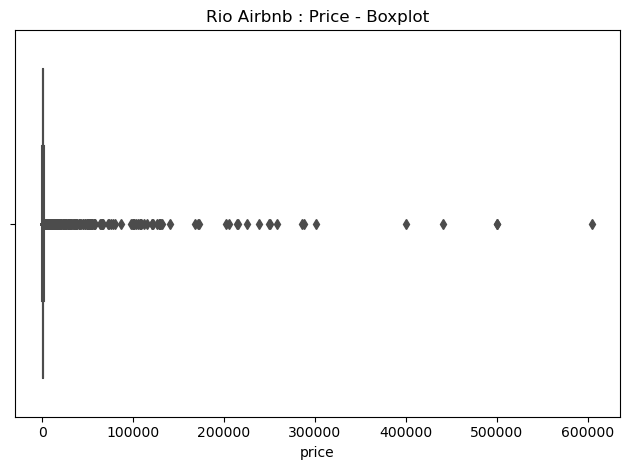

In [286]:
plt.title('Rio Airbnb : Price - Boxplot')
sns.boxplot(x = df['price'], color = 'r');
plt.tight_layout()
plt.savefig('../visualizations/price boxplot.jpg')

* we've got SEVERAL extremely high priced listings. given the number of available listings does this explain why correlation to price was so low between the variables?

In [157]:
df.price.max()

604981.0

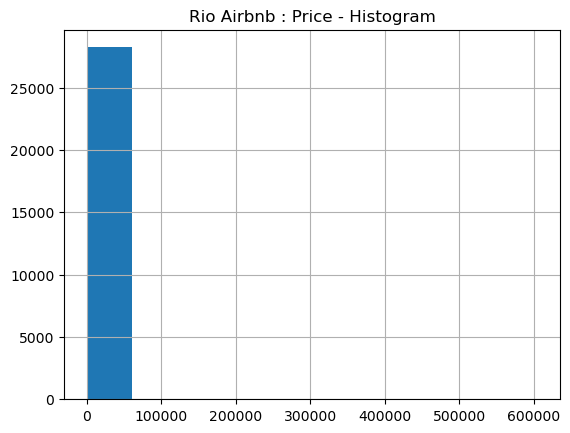

In [158]:
plt.title('Rio Airbnb : Price - Histogram')

df.price.hist();

### * exploring number of people per listing (accommodates)

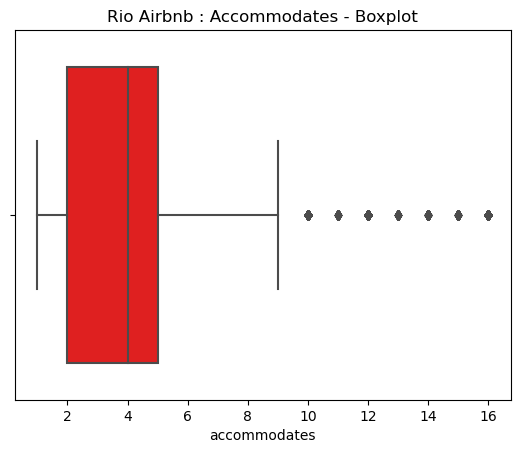

In [159]:
plt.title('Rio Airbnb : Accommodates - Boxplot')
sns.boxplot(x = df['accommodates'], color = 'r');

In [160]:
df.accommodates.max()

16

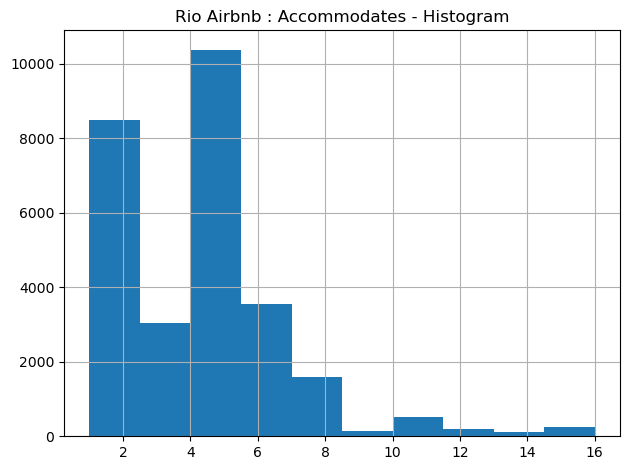

In [310]:
df.accommodates.hist()

plt.title('Rio Airbnb : Accommodates - Histogram')


plt.tight_layout()
plt.savefig('../visualizations/accomodates histogram.jpg')


plt.show()

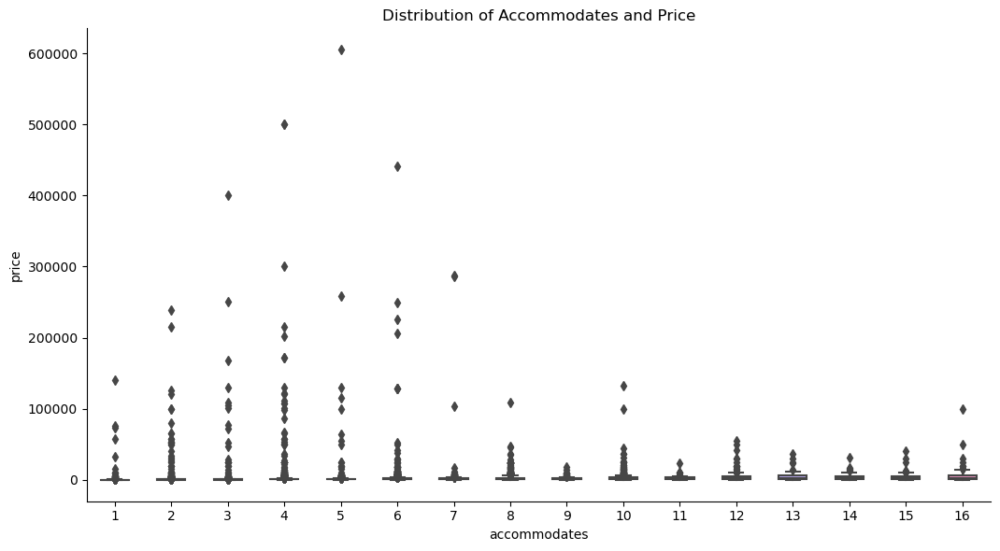

In [289]:
sns.catplot(
    data=df, 
    x='accommodates', y='price', kind='box',
    height=6, aspect=1.8, width=0.5)
plt.title('Distribution of Accommodates and Price')

plt.tight_layout()
plt.savefig('../visualizations/accommoand price.jpg')

* while most listings accomodate between 4 to 6 people, there is no seeming correlation between the number of people a listing can hold and 

In [295]:
price_by_neighbourhood = df.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending = False)
price_by_neighbourhood


neighbourhood_cleansed
Lins de Vasconcelos    15690.285714
São Cristóvão          12171.506494
Sampaio                 8087.615385
Joá                     6385.793388
Senador Vasconcelos     5240.714286
                           ...     
Honório Gurgel            98.666667
Cordovil                  98.000000
Jardim América            76.000000
Tomás Coelho              68.333333
Vila Kosmos               64.000000
Name: price, Length: 152, dtype: float64

* which neighborhoods have the most listings?

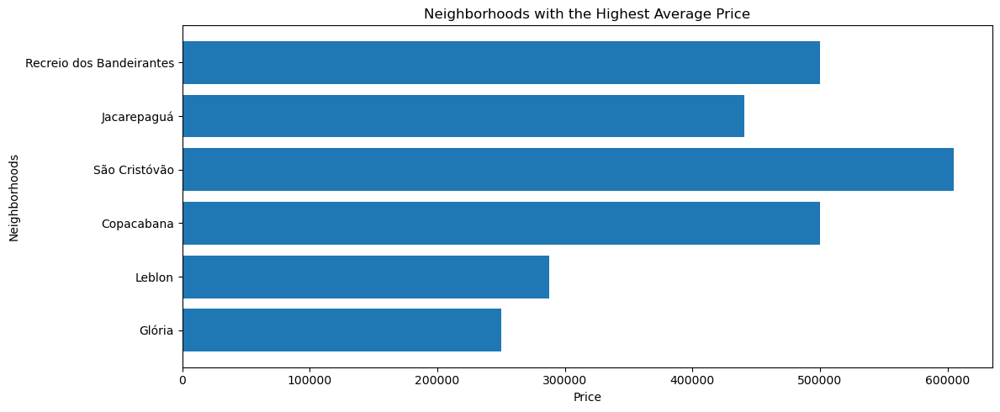

In [308]:
# create a dataframe with only the top 10 highest prices
top_10 = df.nlargest(10, 'price')

# create our figure, think of this as our "canvas"
plt.figure(figsize = (12, 5))

# horizontal bar chart
plt.barh(top_10['neighbourhood_cleansed'][::-1],
         top_10['price'][::-1]) # [::-1] reverses the order

# Add a title
plt.title('Neighborhoods with the Highest Average Price')

# Add axis labels
plt.ylabel('Neighborhoods')
plt.xlabel('Price')

plt.tight_layout()
plt.savefig('../visualizations/ highest list price.jpg')

plt.show()


In [226]:
listings_by_neighbourhood = df.groupby('neighbourhood_cleansed').size().sort_values(ascending=False)
listings_by_neighbourhood


neighbourhood_cleansed
Copacabana          8341
Barra da Tijuca     2857
Ipanema             2822
Jacarepaguá         1476
Leblon              1423
                    ... 
Vila Kosmos            1
Acari                  1
Magalhães Bastos       1
Manguinhos             1
Pitangueiras           1
Length: 152, dtype: int64

* makes sense that Copacabana and Ipanema are among the top three as they are the most popular beaches in Rio

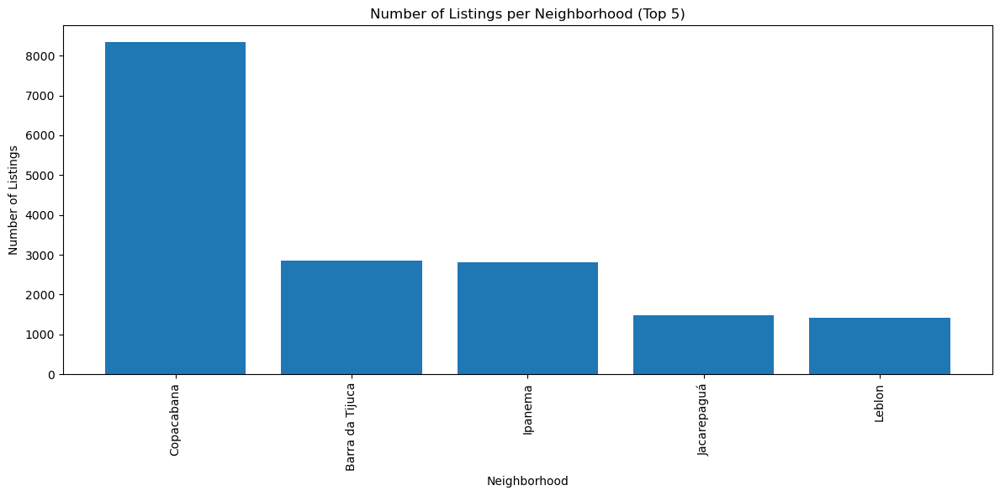

In [307]:
listings_by_neighbourhood = df.groupby('neighbourhood_cleansed').agg({'price': 'mean', 'id': 'size'}).sort_values(by='id', ascending=False).reset_index()
listings_by_neighbourhood.rename(columns={'id': 'number_of_listings', 'price': 'average_price'}, inplace=True)
listings_by_neighbourhood


# create the  bar chart for number of listings per neighborhood (showing only the top 5)
top_5_listings_by_neighbourhood = listings_by_neighbourhood.head(5)
plt.figure(figsize=(12, 6))
plt.bar(top_5_listings_by_neighbourhood['neighbourhood_cleansed'], top_5_listings_by_neighbourhood['number_of_listings'])
plt.title('Number of Listings per Neighborhood (Top 5)')
plt.xlabel('Neighborhood')
plt.ylabel('Number of Listings')
plt.xticks(rotation=90)

plt.tight_layout()
plt.savefig('../visualizations/ listings per.jpg')

plt.show()



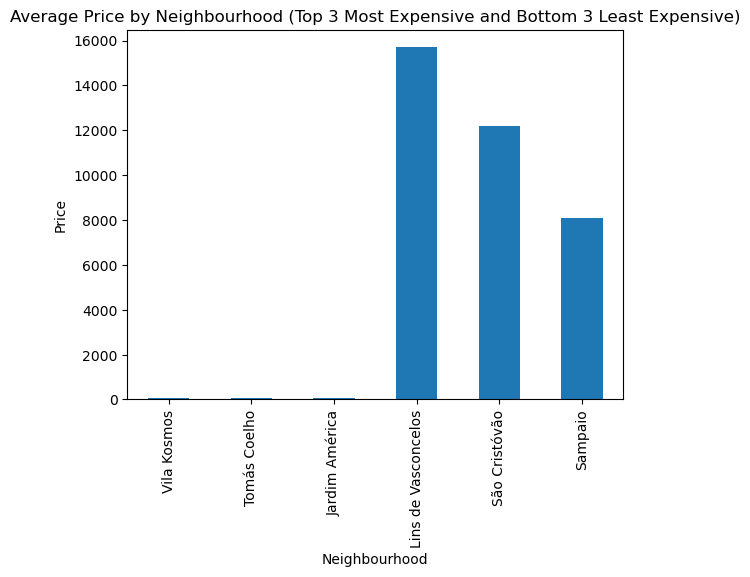

In [164]:
# sort the table by ascending order of price and select the bottom 3 neighbourhoods
bottom_3 = price_by_neighbourhood.sort_values().head(3)

# sort the table by descending order of price and select the top 3 neighbourhoods
top_3 = price_by_neighbourhood.sort_values(ascending=False).head(3)

# combine the two tables into a single table
selected_neighbourhoods = pd.concat([bottom_3, top_3])

# create a bar chart of the selected neighbourhoods
selected_neighbourhoods.plot(kind='bar')

# set the chart title and axis labels
plt.title('Average Price by Neighbourhood (Top 3 Most Expensive and Bottom 3 Least Expensive)')
plt.xlabel('Neighbourhood')
plt.ylabel('Price')

# show the chart
plt.show()

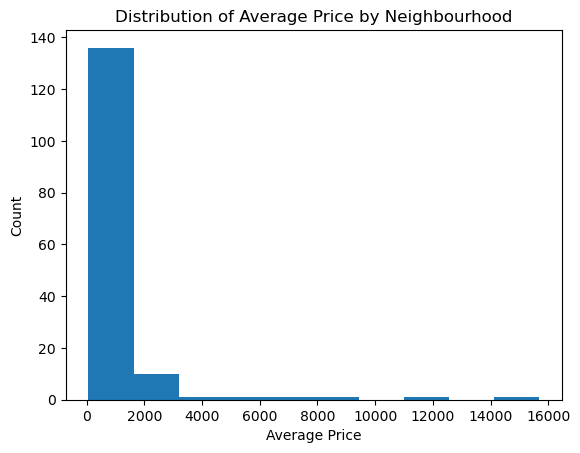

In [165]:
# group the data by neighbourhood_cleansed and calculate the mean price
price_by_neighbourhood = df.groupby('neighbourhood_cleansed')['price'].mean()

# create a histogram of the average price by neighbourhood
plt.hist(price_by_neighbourhood, bins=10)

# set the chart title and axis labels
plt.title('Distribution of Average Price by Neighbourhood')
plt.xlabel('Average Price')
plt.ylabel('Count')

# show the chart
plt.show()

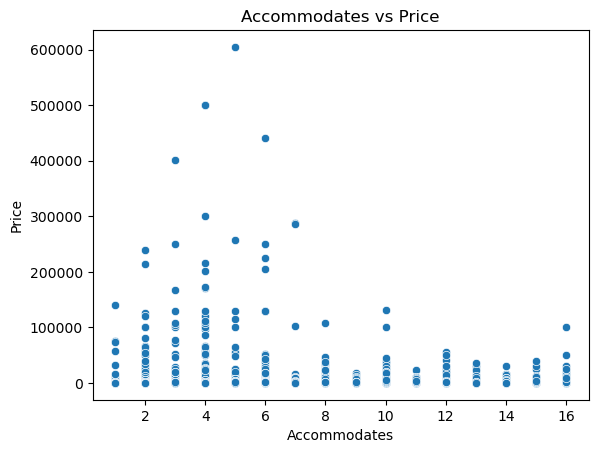

<Figure size 640x480 with 0 Axes>

In [277]:
# Create scatter plot
sns.scatterplot(x='accommodates', y='price', data=df)

# Add labels and title
plt.xlabel('Accommodates')
plt.ylabel('Price')
plt.title('Accommodates vs Price')

# Display plot
plt.show()
plt.savefig('../visualizations/accommodatesvsprice.jpg')


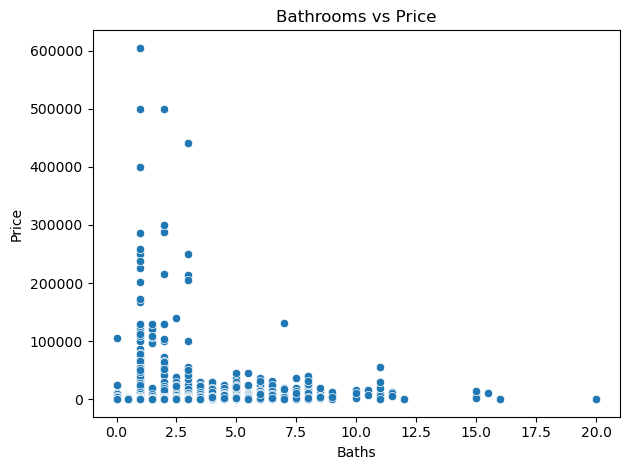

In [284]:
# Create scatter plot
sns.scatterplot(x='baths', y='price', data=df)

# Add labels and title
plt.xlabel('Baths')
plt.ylabel('Price')
plt.title('Bathrooms vs Price')

plt.tight_layout()

plt.savefig('../visualizations/bathsvsprice.jpg')

# Display plot
plt.show()



In [168]:
df.property_category.unique()

array(['Entire', 'Private', 'Other', 'Shared'], dtype=object)

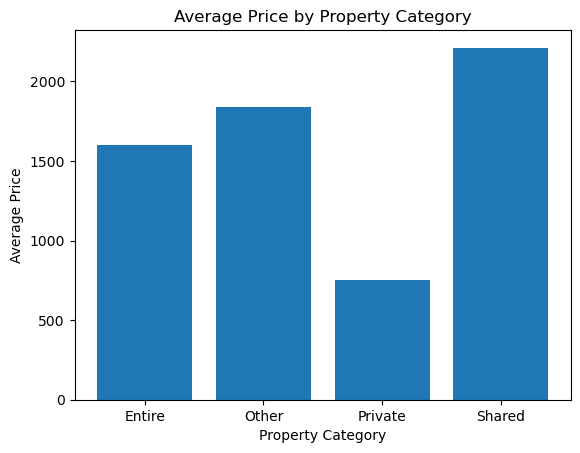

In [169]:
# calculate the average price per value in the 'property_category' column
avg_price_by_category = df.groupby('property_category')['price'].mean()

# create a bar plot to visualize the results
plt.bar(avg_price_by_category.index, avg_price_by_category.values)

# add labels and a title
plt.xlabel('Property Category')
plt.ylabel('Average Price')
plt.title('Average Price by Property Category')

# display the plot
plt.show()

### displaying number of listings clustered by neighborhood
* The resulting map will display a cluster of markers for each location with the number of listings per cluster displayed when zoomed out. When zoomed in, the individual markers for each neighborhood will be displayed with the number of listings in the tooltip.


In [238]:


# Create a new dataframe with the number of listings per neighborhood
listings_by_neighbourhood = df.groupby('neighbourhood_cleansed').agg({'id': 'count', 'latitude': 'mean', 'longitude': 'mean'}).reset_index()
listings_by_neighbourhood.rename(columns={'id': 'number_of_listings'}, inplace=True)

# Define the initial map location
latitude, longitude = df['latitude'].mean(), df['longitude'].mean()

# Create a map
m = folium.Map(location=[latitude, longitude], zoom_start=12)

# Create a MarkerCluster layer
marker_cluster = MarkerCluster().add_to(m)

# Iterate over the listings by neighborhood dataframe and add a marker to the cluster layer for each neighborhood
for index, row in listings_by_neighbourhood.iterrows():
    tooltip = row['neighbourhood_cleansed'] + ': ' + str(row['number_of_listings']) + ' listings'
    folium.Marker(location=[row['latitude'], row['longitude']], tooltip=tooltip).add_to(marker_cluster)

# Display the map
m


### displaying most expensive neighborhoods by average price

In [252]:
import folium

# Create a map centered on Rio de Janeiro
m = folium.Map(location=[-22.9035, -43.2096], zoom_start=12)

# Define a dictionary to hold the colors for each neighborhood
colors = {
    'Copacabana': 'blue',
    'Barra da Tijuca': 'green',
    'Ipanema': 'purple',
    'Jacarepaguá': 'orange',
    'Leblon': 'red'
}

# Iterate over the neighborhoods and add a marker to the map for each one
for neighborhood in ['Copacabana', 'Barra da Tijuca', 'Ipanema', 'Jacarepaguá', 'Leblon']:
    # Get the average price for this neighborhood
    avg_price = df.loc[df['neighbourhood_cleansed'] == neighborhood, 'price'].mean()
    
    # Add a marker to the map with the average price in the tooltip
    folium.Marker(
        location=[df.loc[df['neighbourhood_cleansed'] == neighborhood, 'latitude'].mean(),
                  df.loc[df['neighbourhood_cleansed'] == neighborhood, 'longitude'].mean()],
        tooltip=f"{neighborhood}<br>Average price: {avg_price:.2f} BRL",
        icon=folium.Icon(color=colors[neighborhood])
    ).add_to(m)

# Display the map
m


In [170]:
# calculate the average price by neighborhood
df_agg = df.groupby(['neighbourhood_cleansed'])['price'].median().reset_index()

# create a map centered on the mean latitude and longitude of the listings
map = folium.Map(location=[df['latitude'].median(), df['longitude'].median()], zoom_start=12)

# create a choropleth layer with the neighborhood and average price data
choropleth = folium.Choropleth(
    geo_data='../data/neighbourhoods.geojson',
    name='choropleth',
    data=df_agg,
    columns=['neighbourhood_cleansed', 'price'],
    key_on='feature.properties.neighbourhood',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Median Price per Listing',
    highlight=True
).add_to(map)

# add a layer control to the map
folium.LayerControl().add_to(map)

# display the map
map

### displaying listings by density...
** the coast is by far the most attractive real estate due to the beaches and surrounding topography

In [172]:
# calculate the average price by latitude and longitude
df_agg = df.groupby(['latitude', 'longitude'])['price'].mean().reset_index()

# create a map centered on the mean latitude and longitude
map = folium.Map(location=[df_agg['latitude'].mean(), df_agg['longitude'].mean()], zoom_start=12)

# add markers to the map for each latitude and longitude point, with the marker size and color indicating the average price
for index, row in df_agg.iterrows():
    folium.CircleMarker([row['latitude'], row['longitude']], radius=row['price']/80_000, color='red', fill=True, fill_color='red', fill_opacity=0.5).add_to(map)

# display the map
map

### displaying concentration of listings by heat map

In [285]:
# create a folium map centered on the mean latitude and longitude
mean_lat = df['latitude'].mean()
mean_lon = df['longitude'].mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=11)

# create a list of lat-lon pairs from the dataframe
lat_lon_pairs = list(zip(df['latitude'], df['longitude']))

# create a heatmap layer
heatmap_layer = HeatMap(lat_lon_pairs, radius=15)

# add the heatmap layer to the map
heatmap_layer.add_to(m)

plt.tight_layout()
plt.savefig('../visualizations/heatmap.jpg')

# display the map
m

<Figure size 640x480 with 0 Axes>

_________________________________________________________________________________________________________________________________________________________________

### outliers are a major problem - price, accommodation, 

In [76]:
# Use nlargest() to get the 10 highest values in column 'B'
top_25 = df_imputed['price'].nlargest(25)

# Print the top 10 values
print(top_25)

25657    604981.0
2285     500000.0
20097    500000.0
20022    440690.0
23100    400520.0
7304     300800.0
5061     287449.0
28151    285865.0
23431    258133.0
5887     250350.0
6359     249699.0
18438    238698.0
14933    225651.0
7727     215057.0
3967     214657.0
5807     205751.0
4975     201950.0
27957    172379.0
14758    171699.0
24184    167714.0
12701    140180.0
1545     131960.0
23438    129671.0
18073    129421.0
1940     129247.0
Name: price, dtype: float64


### displaying top 25 most expensive listings

In [73]:
from folium.plugins import FastMarkerCluster

# sort the dataframe by price and select the top 25 listings
df_top = df.sort_values(by='price', ascending=False).head(25)

# create a map centered on the mean latitude and longitude
map = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# iterate through each row of the top 25 listings and add a marker to the map
for index, row in df_top.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']],
                  popup=f"${row['price']:.2f}/night in {row['neighbourhood_cleansed']}",
                  icon=folium.Icon(color='red', icon='home')).add_to(map)

# display the map
map


In [223]:
df.to_csv('../data/data.csv', index=False)


In [91]:
# Use nlargest() to get the 10 highest values in column 'B'
top_25 = df_imputed['price'].nlargest(25)

# Print the top 10 values
print(top_25)

25657    604981.0
2285     500000.0
20097    500000.0
20022    440690.0
23100    400520.0
7304     300800.0
5061     287449.0
28151    285865.0
23431    258133.0
5887     250350.0
6359     249699.0
18438    238698.0
14933    225651.0
7727     215057.0
3967     214657.0
5807     205751.0
4975     201950.0
27957    172379.0
14758    171699.0
24184    167714.0
12701    140180.0
1545     131960.0
23438    129671.0
18073    129421.0
1940     129247.0
Name: price, dtype: float64


In [ ]:
df.name.value_counts()